In [1]:
import os
import gc
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
from solo import hashsolo
import scvi
import decoupler as dc
from bbknn import bbknn
import matplotlib.pyplot as plt
import seaborn as sns


Global seed set to 0


In [2]:
# Function which prints basic Quality Control metrics without any filtering/changing data
def summarize_adata(adata):
    # Calculate the total number of cells and genes
    total_cells = adata.n_obs
    total_genes = adata.n_vars
    
    # Calculate number of cells with fewer than 500 UMI counts
    cells_with_500_or_more = (adata.X.sum(axis=1) >= 500).sum()
    cells_with_less_than_500 = total_cells - cells_with_500_or_more
    print(f"Number of cells with fewer than 500 UMI counts: {cells_with_less_than_500}")

    # Calculate number of cells with fewer than 200 genes
    cells_with_200_or_more_genes = (adata.X > 0).sum(axis=1) >= 200
    cells_with_less_than_200_genes = total_cells - cells_with_200_or_more_genes.sum()
    print(f"Number of cells with fewer than 200 genes: {cells_with_less_than_200_genes}")

    # Calculate number of genes expressed in fewer than 3 cells
    genes_with_3_or_more_cells = (adata.X > 0).sum(axis=0) >= 3
    genes_with_less_than_3_cells = total_genes - genes_with_3_or_more_cells.sum()
    print(f"Number of genes expressed in fewer than 3 cells: {genes_with_less_than_3_cells}")
    

    # Print current status of the AnnData object
    print(f"Current Anndata has {adata.n_obs} cells and {adata.n_vars} genes, with a total amount of {adata.X.sum()} UMI counts")

def QC_filter_adata(adata, mt_threshold=5, min_counts=500, min_genes=200, min_cells=3):
    """
    Perform quality control filtering on AnnData object.

    Parameters:
    adata (AnnData): The input AnnData object.
    mt_threshold (float): Threshold for the percentage of mitochondrial genes. Default is 5.
    min_counts (int): Minimum number of counts required for a cell. Default is 500.
    min_genes (int): Minimum number of genes required for a cell. Default is 200.
    min_cells (int): Minimum number of cells required for a gene to be kept. Default is 3.

    Returns:
    AnnData: The filtered AnnData object.
    """
    
    # Annotate the group of mitochondrial genes as 'mt'
    adata.var["mt"] = adata.var_names.str.startswith("mt-")

    # Calculate QC metrics
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True)

    # Visualize QC metrics before filtering
    print("Visualizations before filtering:")
    sc.pl.violin(adata, ["n_genes_by_counts", "total_counts", "pct_counts_mt"], jitter=0.4, multi_panel=True)
    sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_mt")

    # Print the number of cells with more than mt_threshold percent mitochondrial genes
    cells_with_more_than_mt_threshold = (adata.obs["pct_counts_mt"] > mt_threshold).sum()
    print(f"{cells_with_more_than_mt_threshold} of {adata.n_obs} cells contain more than {mt_threshold}% mitochondrial genes. Will be filtered")

    # Filter cells with more than mt_threshold percent mitochondrial genes
    adata = adata[adata.obs.pct_counts_mt < mt_threshold, :]
    sc.pp.filter_cells(adata, min_counts=min_counts)
    sc.pp.filter_cells(adata, min_genes=min_genes)
    sc.pp.filter_genes(adata, min_cells=min_cells)

    # Recalculate QC metrics for the filtered data
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True)

    # Visualize QC metrics after filtering
    print("Visualizations after filtering:")
    sc.pl.violin(adata, ["n_genes_by_counts", "total_counts", "pct_counts_mt"], jitter=0.4, multi_panel=True)
    sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_mt")

    return adata

# Example usage:
# adata = sc.read_h5ad('path_to_your_anndata.h5ad')
# adata = QC_filter_adata(adata, mt_threshold=5, min_counts=500, min_genes=200, min_cells=3)


def hash_demulitplex(adata, hashtag_prefix='Hashtag'):
    """
    Function to demultiplex droplets using the Hashsolo package.
    
    Parameters:
    adata (AnnData): The input AnnData object.
    hashtag_prefix (str): The prefix for hashtag genes in the var gene_ids.
    
    Returns:
    AnnData: The updated AnnData object with demultiplexing results.
    """
    
    # Check if hashtag genes are present
    hashtag_genes = adata.var.gene_ids.str.startswith(hashtag_prefix)
    if sum(hashtag_genes) == 0:
        print(f"No genes with prefix '{hashtag_prefix}' found.")
        return adata

    # Extract hashtag data
    hto = adata[:, hashtag_genes].copy()
    
    # Run HashSolo
    hashsolo.hashsolo(hto)

    # Print the number of predicted singlets, doublets, and negatives
    singlets = sum(hto.obs['most_likely_hypothesis'] == 1)
    doublets = sum(hto.obs['most_likely_hypothesis'] == 2)
    negatives = sum(hto.obs['most_likely_hypothesis'] == 0)
    print(f'Number of predicted singlets: {singlets}')
    print(f'Number of predicted doublets: {doublets}')
    print(f'Number of predicted negatives: {negatives}')
    
    # Print the number of cells classified to each hashtag
    classifications = hto.obs['Classification'].value_counts()
    print('Number of cells for each hashtag:')
    for classification, count in classifications.items():
        print(f'{classification}: {count}')
    
    # Map classifications back to original AnnData object
    adata.obs['Classification'] = hto.obs['Classification'].map(lambda x: adata.var.index[adata.var['gene_ids'] == x][0] if x in adata.var['gene_ids'].values else x)

    # Update the original AnnData object with the most likely hypothesis and classification
    adata.obs['most_likely_hypothesis'] = hto.obs['most_likely_hypothesis']
    
    return adata

# Example usage:
# adata = sc.read_h5ad('path_to_your_anndata.h5ad')
# adata = demultiplex_droplets(adata)

def annotate_cellcycle_mouse(adata):
    # Get cell cycle genes from the regev lab data file. sort/split into appropriate lists
    cell_cycle_genes = [x.strip().lower().title() for x in open('../regev_lab_cell_cycle_genes.txt')]
    s_genes = cell_cycle_genes[:43]
    g2m_genes = cell_cycle_genes[43:]
    cell_cycle_genes = [x.lower().title() for x in cell_cycle_genes if x.lower().title() in adata.var_names]
    # Cell cycle scoring function from scanpy
    sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

    # subset adata with only necessary genes
    adata_cc_genes = adata[:, cell_cycle_genes]
    

    adata.obs["cellcycle"] = adata_cc_genes.obs["phase"]
    adata.obs["S_score"] = adata_cc_genes.obs["S_score"]
    adata.obs["G2M_score"] = adata_cc_genes.obs["G2M_score"]
    
    return adata

# Function to generate a dictionary of lists of genes relevant to analysis which are present in the dataset
def find_genes(adata):
    #define some lists of genes of interest for the analysis.
    Genes_of_interest = []
    homeo_genes = ['Sall1', 'Cx3cr1', 'P2ry12', 'P2ry13', 'Olfml3', 'Tmem119', 'Cd68', 'Itgam', 'Cst3']
    DAM_genes = ['Apoe', 'B2m', 'Ctsb', 'Lpl', 'Cst7', 'Tyrobp', 'Trem2', 'Cd9', 'Itgax', 'Cd63', 'Fth1', 'Spp1', 'Axl', 'Mertk', 'Mdk', 'Ptn']
    Mapk_genes = ['Syk', 'Prkca', 'Mef2c', 'Elk4', 'Trp53', 'Mertk', 'Axl', 'Mapk14', 'Mapk1', 'Gadd45a',]
    Nfkb_genes = ['Nfkb1', 'Tlr4', 'Nfkbia', 'Cd40', 'Tlr4', 'Rela', 'Relb']
    Macroph_genes = ['Mrc1', 'Mrc2', 'Ccr2', 'Ly6c2', 'Lyz2', 'Vim', 'Ifi204', 'S100a10', 'Msrb1']
    # make a dictionary of the lists to iterate through
    gene_lists = {"Homeo": homeo_genes, "DAM": DAM_genes, "Mapk": Mapk_genes, "Nfkb": Nfkb_genes, "Macroph": Macroph_genes}
    found_genes = {key: [] for key in gene_lists.keys()}

    # loop through gene lists and genes, see if it is present in the passed adata, if so append it to a list+dictionary 
    # so we have a dicitonary of lists of only genes in the dataset, as well as a list of all genes from the different types
    for gene_list_name, gene_list in gene_lists.items():
        for gene in gene_list:
            if gene in adata.var.index:
                print(f" ✓ {gene} is in adata.var")
                Genes_of_interest.append(gene)
                found_genes[gene_list_name].append(gene)
            else:
                print(f"{gene} is not in adata.var")

    return Genes_of_interest, found_genes

import scanpy as sc

def gene_expression_percentage(adata, gene_id, category, logfc_threshold=0.5):
    """
    Prints the percentage of cells in which the specified gene is expressed above 0 and above a given logFC threshold,
    both in total and within each group of the specified category.

    Parameters:
    adata (AnnData): The AnnData object containing single-cell RNA sequencing data.
    gene_id (str): The ID of the gene to analyze.
    category (str): The name of the category in adata.obs to group the cells.
    logfc_threshold (float): The log fold-change threshold for considering a gene as expressed. Default is 0.5.
    """
    if gene_id not in adata.var_names:
        print(f"Gene {gene_id} not found in the dataset.")
        return

    if category not in adata.obs:
        print(f"Category {category} not found in adata.obs.")
        return

    # Get the expression values for the gene across all cells
    gene_expression = adata[:, gene_id].X

    # Flatten the array to ensure it's a 1D array
    gene_expression = gene_expression.A.flatten() if hasattr(gene_expression, "A") else gene_expression

    # Calculate the percentage of cells with expression > 0 in total
    total_cells = gene_expression.shape[0]
    expressed_cells = (gene_expression > 0).sum()
    percentage_expressed = (expressed_cells / total_cells) * 100

    # Calculate the percentage of cells with expression > logfc_threshold in total
    highly_expressed_cells = (gene_expression > logfc_threshold).sum()
    percentage_highly_expressed = (highly_expressed_cells / total_cells) * 100

    print(f"Gene {gene_id}:")
    print(f"Total percentage of cells with expression > 0: {percentage_expressed:.2f}%")
    print(f"Total percentage of cells with expression > {logfc_threshold} logFC: {percentage_highly_expressed:.2f}%")

    # Get the unique groups in the specified category
    groups = adata.obs[category].unique()

    # Calculate the percentages within each group
    for group in groups:
        group_mask = adata.obs[category] == group
        group_gene_expression = gene_expression[group_mask]

        group_total_cells = group_gene_expression.shape[0]
        group_expressed_cells = (group_gene_expression > 0).sum()
        group_percentage_expressed = (group_expressed_cells / group_total_cells) * 100

        group_highly_expressed_cells = (group_gene_expression > logfc_threshold).sum()
        group_percentage_highly_expressed = (group_highly_expressed_cells / group_total_cells) * 100

        print(f"\nGroup '{group}':")
        print(f"Percentage of cells with expression > 0: {group_percentage_expressed:.2f}%")
        print(f"Percentage of cells with expression > {logfc_threshold} logFC: {group_percentage_highly_expressed:.2f}%")

# Example usage
# Assuming 'adata' is your pre-processed AnnData object, 'gene_id' is the gene you want to analyze,
# and 'category' is the annotation in adata.obs (e.g., 'leiden' or any other category)
# gene_expression_percentage_by_category(adata, 'gene_id', 'category')


In [3]:
# Read each sequencing run data into a dictionary, with a name for each as the key
adatas = {
    "D1" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/collect_tube_1_batch_3_June_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D2" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/collect_tube_2_batch_3_june_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D3" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Isol_Microglia_EFAD_TD_august_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D4" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/MICROGLIA_E3E4FAD_TD_23_05_2023_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D5" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube_1_July_20_TD_YYRFC_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D6" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube2_July_20_TD_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D7" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube3_july_20_TD_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    }

In [4]:
# Print Quality Control metric for each dataset
for adata_key, adata in adatas.items():
    print(f"{adata_key}:")
    summarize_adata(adata)
    print("\n")

D1:
Number of cells with fewer than 500 UMI counts: 0
Number of cells with fewer than 200 genes: 0
Number of genes expressed in fewer than 3 cells: 18651
Current Anndata has 3723 cells and 33993 genes, with a total amount of 34316840.0 UMI counts


D2:
Number of cells with fewer than 500 UMI counts: 0
Number of cells with fewer than 200 genes: 0
Number of genes expressed in fewer than 3 cells: 18272
Current Anndata has 5399 cells and 33993 genes, with a total amount of 36420872.0 UMI counts


D3:
Number of cells with fewer than 500 UMI counts: 0
Number of cells with fewer than 200 genes: 0
Number of genes expressed in fewer than 3 cells: 18124
Current Anndata has 5584 cells and 33993 genes, with a total amount of 38237432.0 UMI counts


D4:
Number of cells with fewer than 500 UMI counts: 0
Number of cells with fewer than 200 genes: 1
Number of genes expressed in fewer than 3 cells: 18683
Current Anndata has 4315 cells and 33993 genes, with a total amount of 35763896.0 UMI counts


D5:


D1:
Visualizations before filtering:


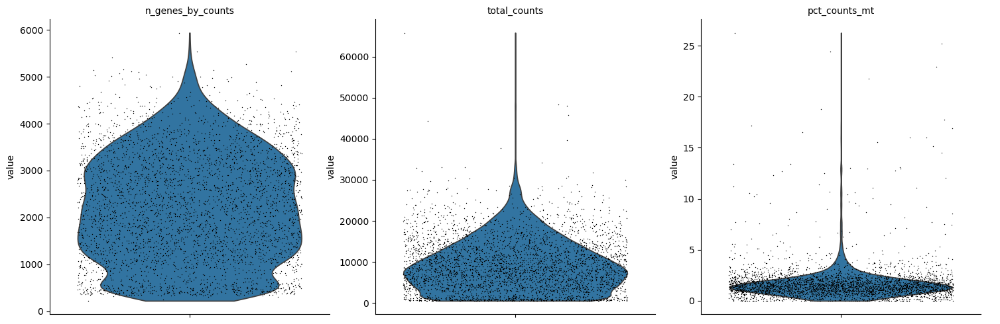

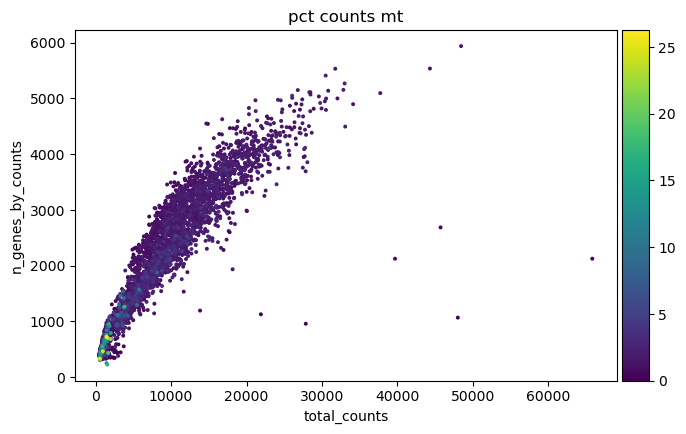

87 of 3723 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


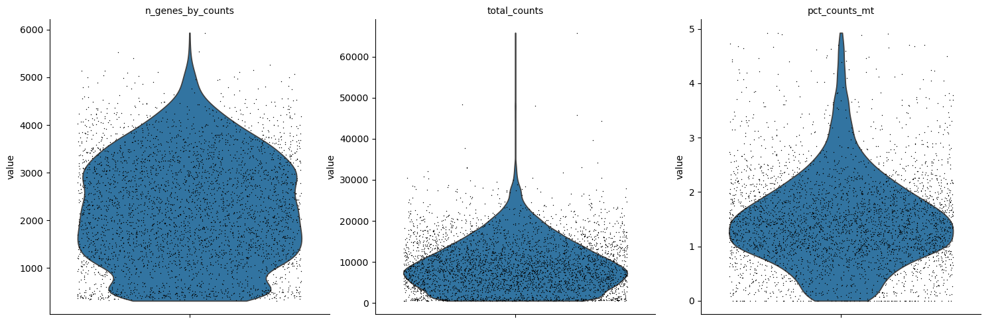

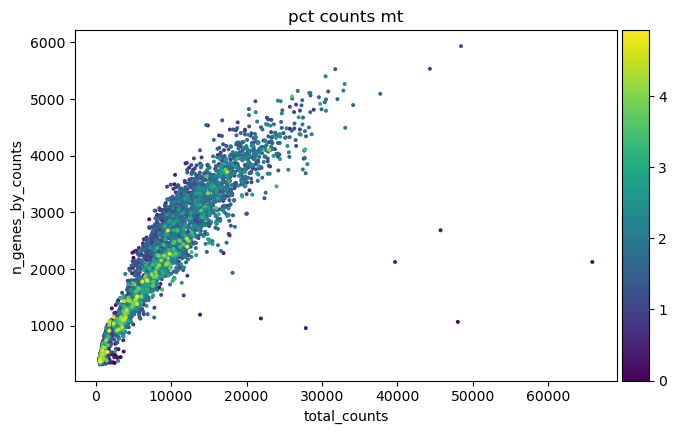



D2:
Visualizations before filtering:


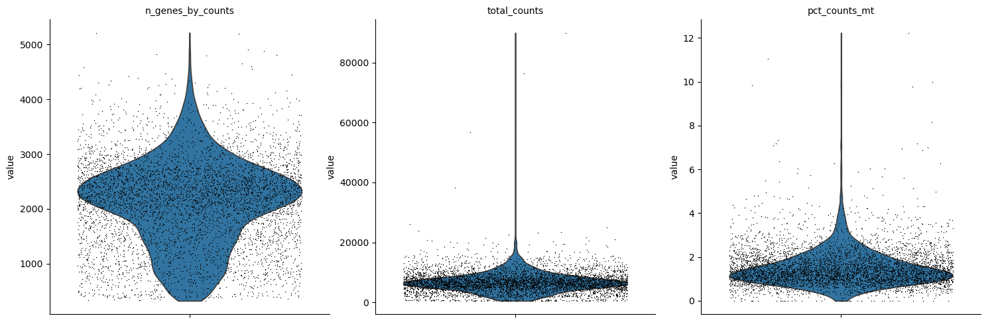

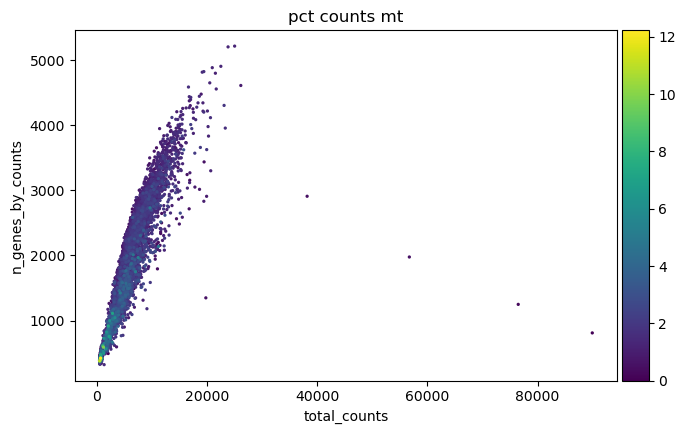

30 of 5399 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


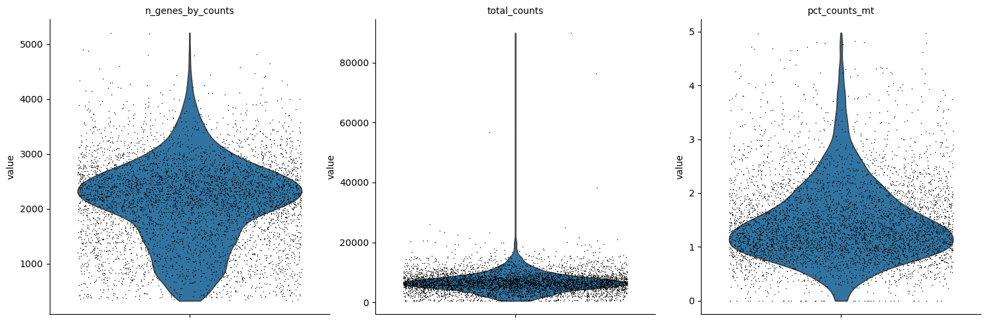

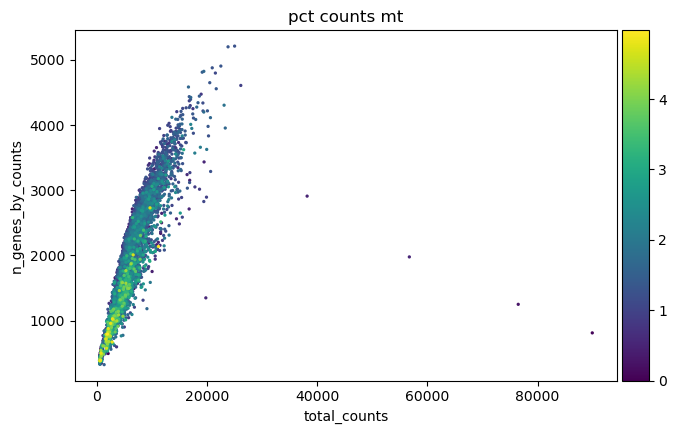



D3:
Visualizations before filtering:


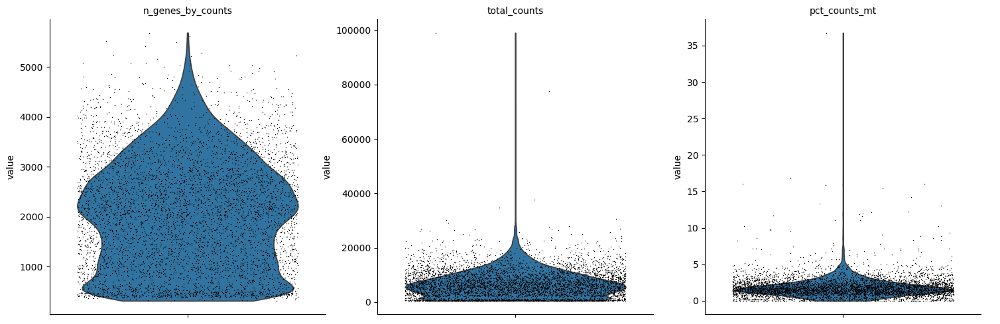

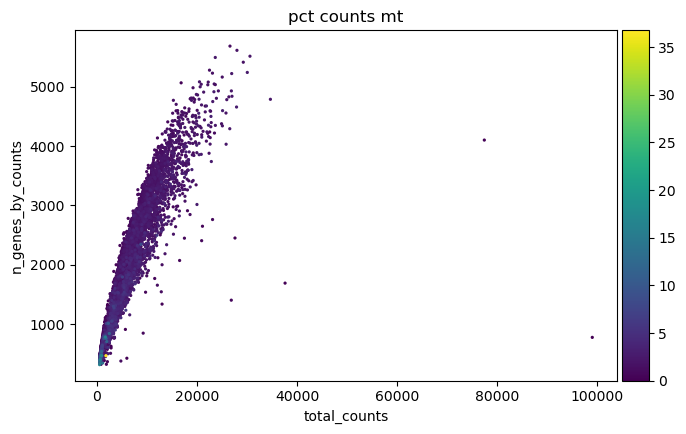

96 of 5584 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


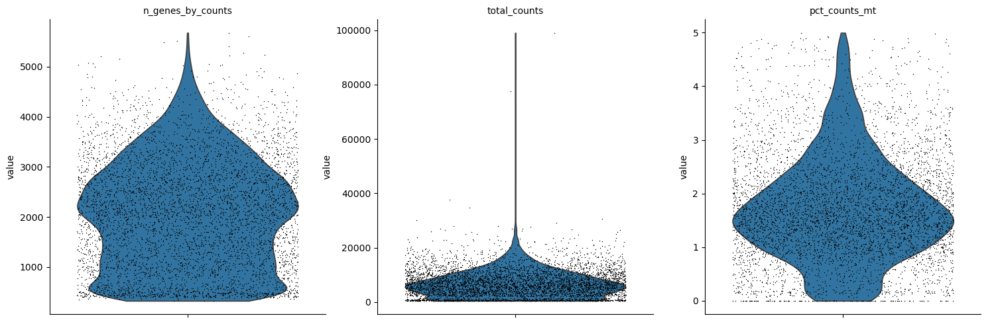

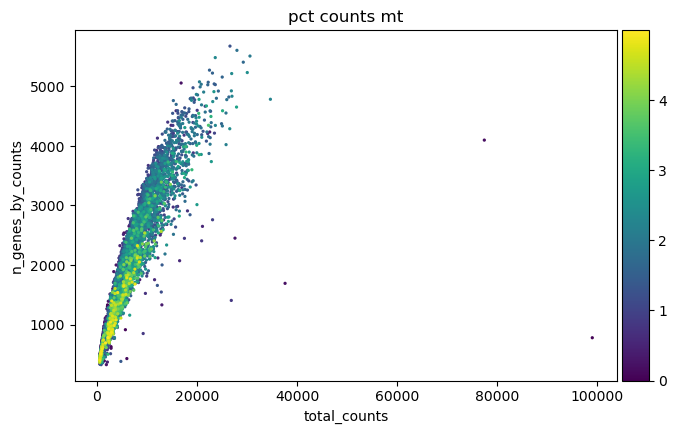



D4:
Visualizations before filtering:


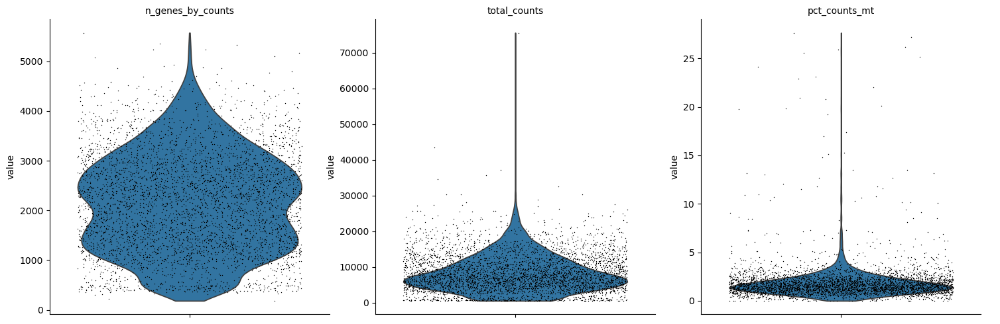

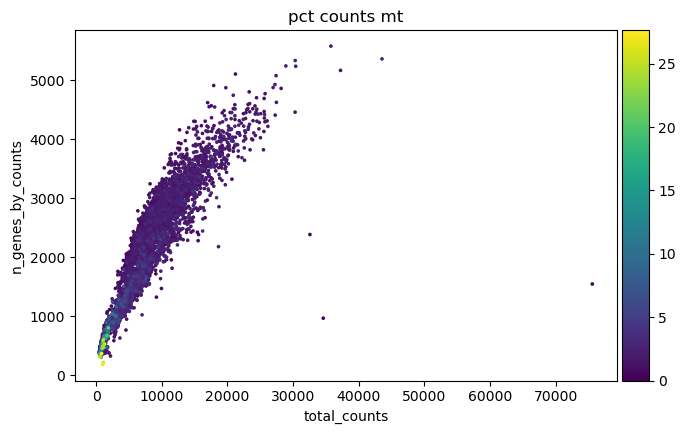

107 of 4315 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


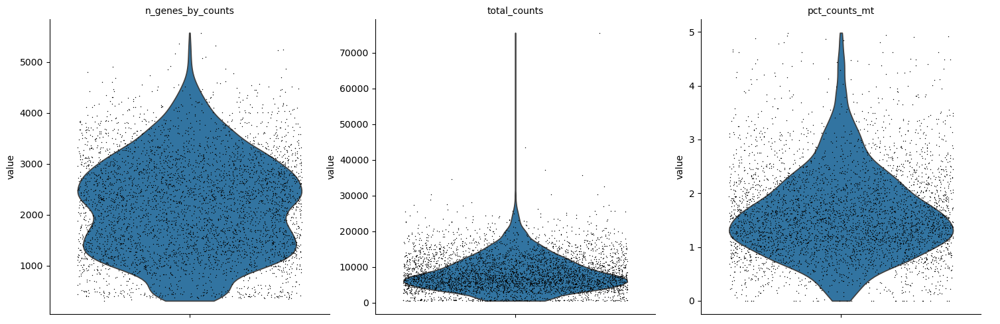

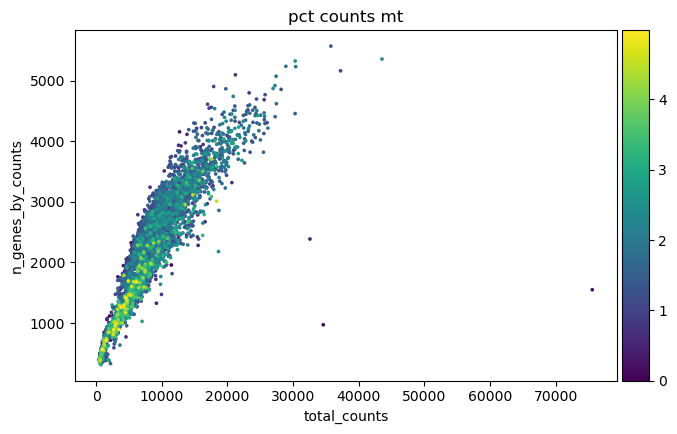



D5:
Visualizations before filtering:


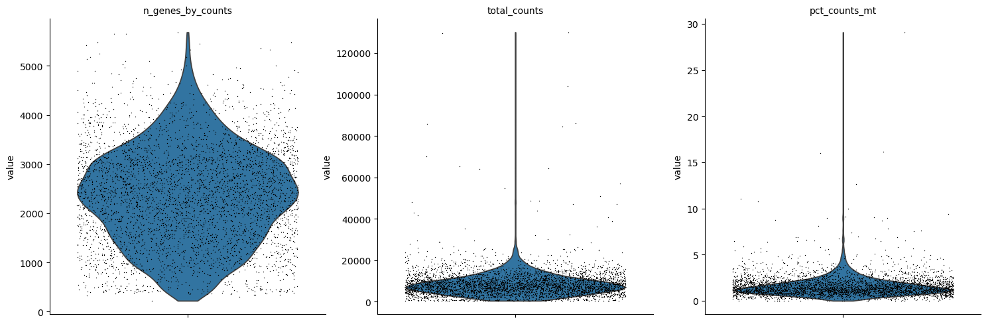

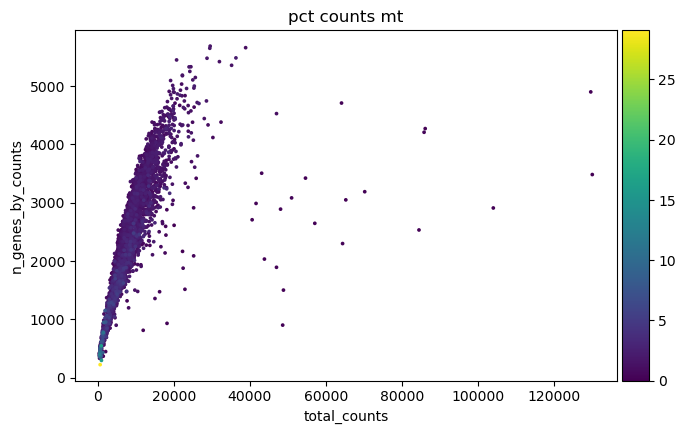

50 of 4159 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


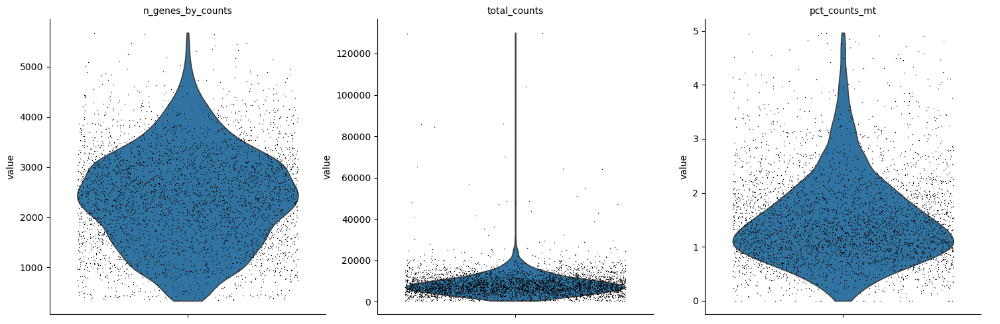

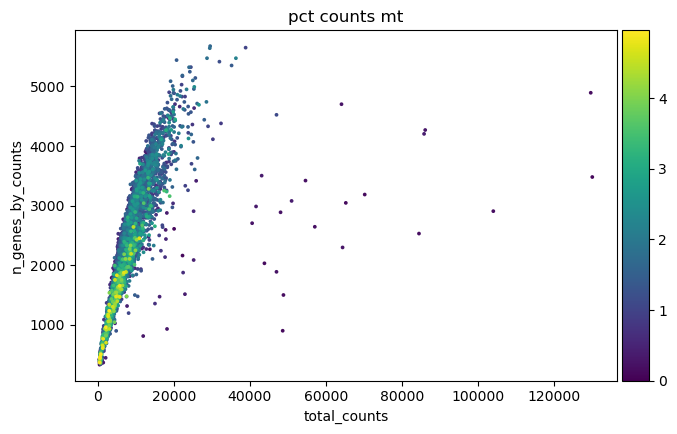



D6:
Visualizations before filtering:


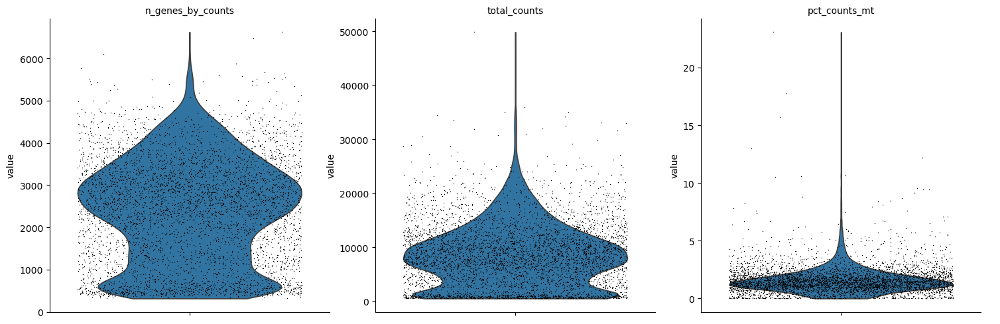

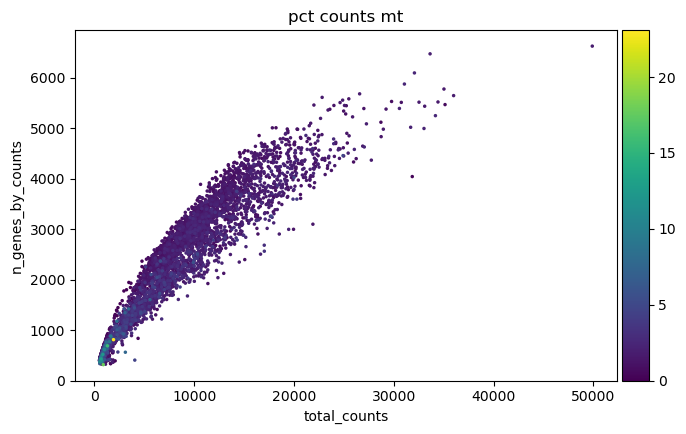

78 of 4757 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


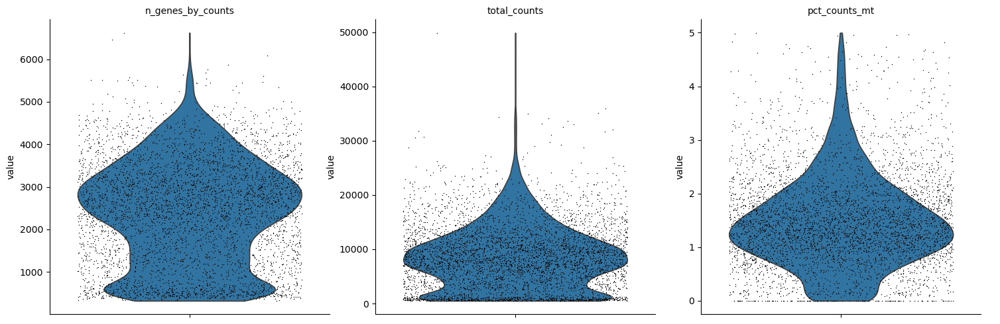

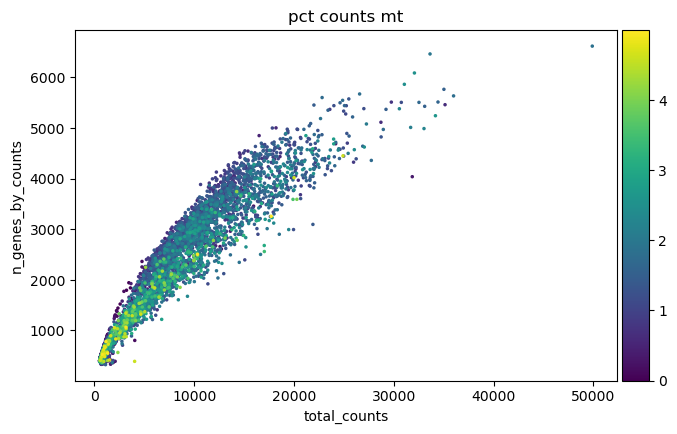



D7:
Visualizations before filtering:


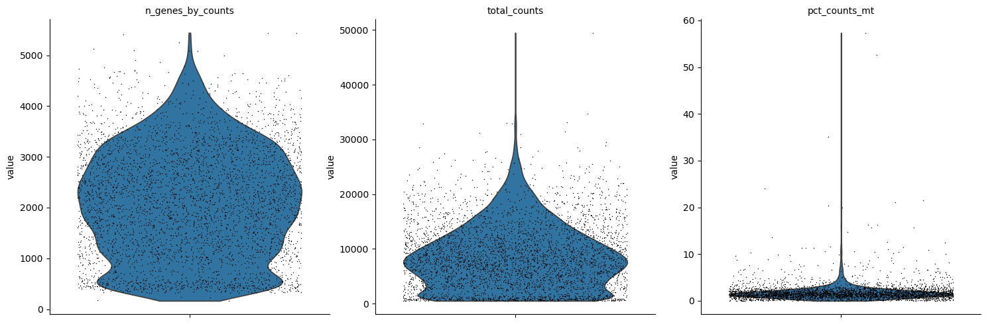

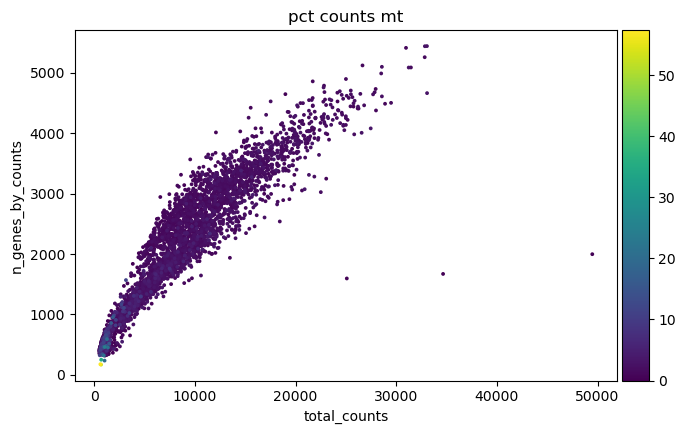

122 of 4010 cells contain more than 5% mitochondrial genes. Will be filtered


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Visualizations after filtering:


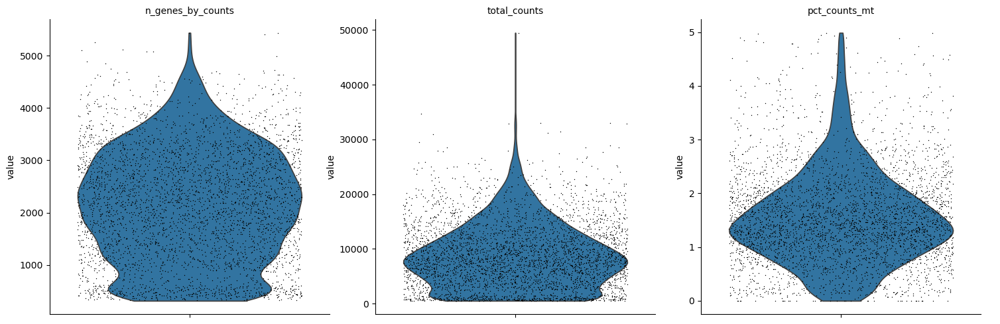

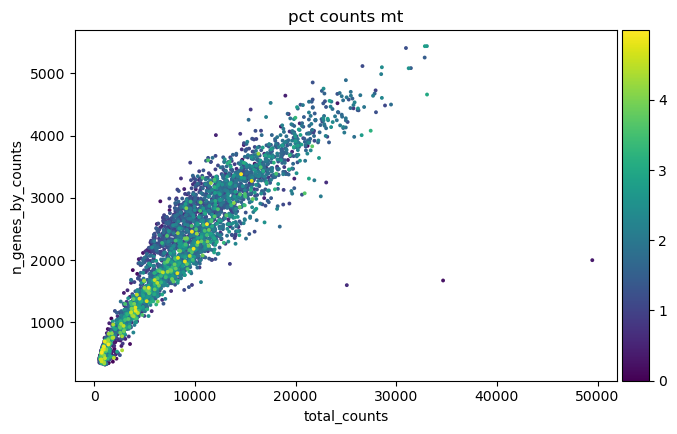

In [5]:
# Basic QC thresholds
QC_filtered_adatas = {}
for adata_key, adata in adatas.items():
    print(f"{adata_key}:")
    QC_filtered_adatas[adata_key] = QC_filter_adata(adata)
    print("\n")



In [6]:
# Print Quality Control metric for each dataset
for adata_key, adata in QC_filtered_adatas.items():
    print(f"{adata_key}:")
    hash_demulitplex(adata)
    print("\n")

D1:
Number of predicted singlets: 3318
Number of predicted doublets: 245
Number of predicted negatives: 73
Number of cells for each hashtag:
K234: 875
K219: 843
K233: 821
K231: 779
Doublet: 245
Negative: 73


D2:
Number of predicted singlets: 5014
Number of predicted doublets: 275
Number of predicted negatives: 80
Number of cells for each hashtag:
G180: 1283
G146: 1265
G143: 1250
K232: 1216
Doublet: 275
Negative: 80


D3:
Number of predicted singlets: 4941
Number of predicted doublets: 502
Number of predicted negatives: 45
Number of cells for each hashtag:
K261: 1427
K257: 1264
K262: 1253
K268: 997
Doublet: 502
Negative: 45


D4:
Number of predicted singlets: 3818
Number of predicted doublets: 327
Number of predicted negatives: 63
Number of cells for each hashtag:
G122: 1150
G119: 919
G120: 875
G118: 874
Doublet: 327
Negative: 63


D5:
Number of predicted singlets: 3787
Number of predicted doublets: 286
Number of predicted negatives: 36
Number of cells for each hashtag:
G184: 1065
G183

In [7]:
for adata_key, adata in QC_filtered_adatas.items():
    print(f"dataset {adata_key}:")
    for index, row in adata.var.iterrows():
        if row['feature_types'] == 'Antibody Capture':
            print(f"gene_ids: {row['gene_ids']}, Name: {index}")



dataset D1:
gene_ids: Hashtag_1, Name: K231
gene_ids: Hashtag_2, Name: K233
gene_ids: Hashtag_3, Name: K234
gene_ids: Hashtag_4, Name: K219
dataset D2:
gene_ids: Hashtag_1, Name: G143
gene_ids: Hashtag_2, Name: G146
gene_ids: Hashtag_3, Name: K232
gene_ids: Hashtag_4, Name: G180
dataset D3:
gene_ids: Hashtag_1, Name: K257
gene_ids: Hashtag_2, Name: K261
gene_ids: Hashtag_3, Name: K262
gene_ids: Hashtag_4, Name: K268
dataset D4:
gene_ids: Hashtag_1, Name: G118
gene_ids: Hashtag_2, Name: G119
gene_ids: Hashtag_3, Name: G120
gene_ids: Hashtag_4, Name: G122
dataset D5:
gene_ids: Hashtag_1, Name: G183
gene_ids: Hashtag_2, Name: G184
gene_ids: Hashtag_3, Name: G185
gene_ids: Hashtag_4, Name: G186
dataset D6:
gene_ids: Hashtag_1, Name: K248
gene_ids: Hashtag_2, Name: K249
gene_ids: Hashtag_3, Name: K250
gene_ids: Hashtag_4, Name: K252
dataset D7:
gene_ids: Hashtag_1, Name: G177
gene_ids: Hashtag_2, Name: G178
gene_ids: Hashtag_3, Name: G179
gene_ids: Hashtag_4, Name: G145


In [21]:
genotype_map = {"K191" : "E3FAD", "K192" : "E3FAD", "K190" : "E3WT", "K193" : "E3WT", 
                "G118" : "E4FAD", "G119" : "E4FAD", "G120" : "E4FAD", "G122" : "E4WT",
                "K231" : "E3FAD", "K233" : "E3FAD", "K234" : "E3FAD", "K219" : "E4FAD",
                "G143" : "E4WT", "G146" : "E4WT", "K232" : "E3WT", "G180" : "E4WT", 
                "G183" : "E4WT", "G184" : "E4WT", "G185" : "E4WT", "G186" : "E4FAD",
                "K248" : "E3WT", "K249" : "E3WT", "K250" : "E3FAD", "K252" : "E3FAD", 
                "G177" : "E4FAD", "G178" : "E4FAD", "G179" : "E4FAD", "G145" : "E4FAD",
                "K257" : "E3WT", "K261" : "E3WT", "K262" : "E3WT", "K268" : "E3FAD",
                "K283" : "E3WT", "K284" : "E3FAD"}
treatment_map = {"K191" : "LPS", "K192" : "LPS", "K190" : "LPS", "K193" : "LPS", 
                "G118" : "VEHICLE", "G119" : "VEHICLE", "G120" : "VEHICLE", "G122" : "VEHICLE",
                "K231" : "VEHICLE", "K233" : "VEHICLE", "K234" : "VEHICLE", "K219" : "LPS",
                "G143" : "LPS", "G146" : "LPS", "K232" : "VEHICLE", "G180" : "LPS", 
                "G183" : "VEHICLE", "G184" : "VEHICLE", "G185" : "VEHICLE", "G186" : "VEHICLE",
                "K248" : "LPS", "K249" : "LPS", "K250" : "LPS", "K252" : "LPS", 
                "G177" : "LPS", "G178" : "LPS", "G179" : "LPS", "G145" : "LPS",
                "K257" : "VEHICLE", "K261" : "VEHICLE", "K262" : "VEHICLE", "K268" : "VEHICLE",
                "K283" : "LPS", "K284" : "LPS"}


adata = ad.concat(QC_filtered_adatas, label="sample", join="outer", merge="unique")

adata = adata[:, adata.var_names != 'Malat1']
adata = adata[:, adata.var_names != 'Xist']
adata = adata[:, adata.var_names != 'Mir142hg']
adata = adata[:, adata.var_names != 'Jun']
adata = adata[:, adata.var_names != 'Jund']
adata = adata[:, adata.var_names != 'Junb']

adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))

# Mapping for apoe (first two characters of the genotype value)
adata.obs["apoe"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None)[:2] if genotype_map.get(x, None) else None)

# Mapping for disease (characters after the first two characters of the genotype value)
adata.obs["disease"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None)[2:] if genotype_map.get(x, None) else None)
adata.obs["treatment"] = adata.obs["Classification"].map(lambda x: treatment_map.get(x, None))
adata
    

/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_64900/2014269022.py:30: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 31377 × 17543
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'Classification', 'most_likely_hypothesis', 'sample', 'genotype', 'apoe', 'disease', 'treatment'

In [22]:
# Print number of adata.obs for each category in adata.obs['sample']
print("Sample counts:")
print(adata.obs['sample'].value_counts())

# Print number of adata.obs for each category in adata.obs['treatment']
print("\nTreatment counts:")
print(adata.obs['treatment'].value_counts())
# Print number of adata.obs for each category in adata.obs['genotype']
print("\nAPOE counts:")
print(adata.obs['apoe'].value_counts())

# Print number of adata.obs for each category in adata.obs['genotype']
print("\nDisease phenotype counts:")
print(adata.obs['disease'].value_counts())

# Print number of adata.obs for each category in adata.obs['genotype']
print("\nGenotype counts:")
print(adata.obs['genotype'].value_counts())

Sample counts:
sample
D3    5488
D2    5369
D6    4679
D4    4208
D5    4109
D7    3888
D1    3636
Name: count, dtype: int64

Treatment counts:
treatment
VEHICLE    16237
LPS        12495
Name: count, dtype: int64

APOE counts:
apoe
E4    15772
E3    12960
Name: count, dtype: int64

Disease phenotype counts:
disease
WT     15573
FAD    13159
Name: count, dtype: int64

Genotype counts:
genotype
E4WT     7976
E4FAD    7796
E3WT     7597
E3FAD    5363
Name: count, dtype: int64


Text(0, 0.5, 'Number of cells')

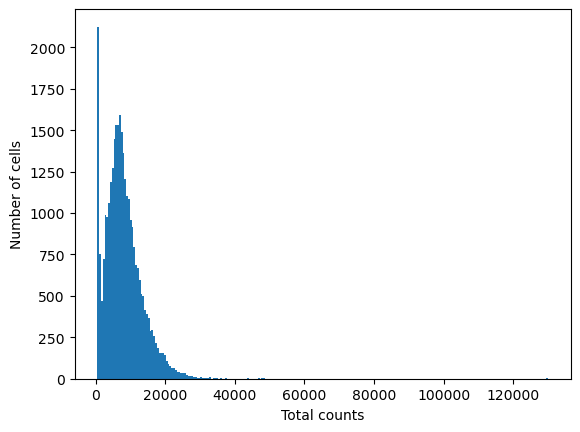

In [23]:
plt.hist(adata.obs["total_counts"], bins=250, log=False, label="Total counts in bins of 100")
plt.xlabel("Total counts")
plt.ylabel("Number of cells")

In [24]:
# Here we store the raw (un-normalized) counts in a different layer called 'counts'
adata.layers["counts"] = adata.X.copy()

(array([2.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 1.000e+00,
        1.000e+00, 2.000e+00, 1.000e+00, 4.000e+00, 1.000e+00, 4.000e+00,
        6.000e+00, 8.000e+00, 7.000e+00, 1.000e+01, 1.900e+01, 1.200e+01,
        1.800e+01, 4.000e+01, 4.200e+01, 4.200e+01, 4.700e+01, 5.900e+01,
        6.000e+01, 6.500e+01, 7.500e+01, 1.180e+02, 1.570e+02, 2.410e+02,
        2.550e+02, 2.600e+02, 2.530e+02, 2.490e+02, 2.310e+02, 2.490e+02,
        2.590e+02, 2.810e+02, 3.110e+02, 3.210e+02, 3.170e+02, 3.980e+02,
        4.350e+02, 4.780e+02, 4.480e+02, 4.980e+02, 5.830e+02, 6.100e+02,
        6.360e+02, 6.120e+02, 5.970e+02, 6.480e+02, 6.490e+02, 6.260e+02,
        6.230e+02, 5.640e+02, 5.510e+02, 5.330e+02, 5.700e+02, 6.050e+02,
        6.560e+02, 7.820e+02, 8.430e+02, 8.680e+02, 1.001e+03, 1.022e+03,
        1.065e+03, 1.166e+03, 1.122e+03, 1.052e+03, 1.004e+03, 9.870e+02,
        8.030e+02, 7.300e+02, 6.220e+02, 5.750e+02, 4.540e+02, 4.030e+02,
        3.360e+02, 2.530e+02, 2.120e+0

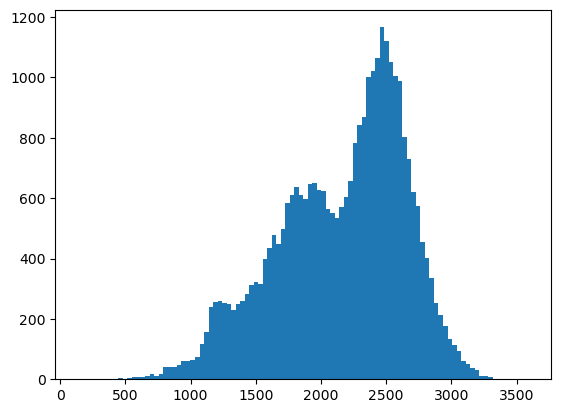

In [25]:
# normalize and log the data and store that in a different layer too incase we need to switch between them.
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()
#so we can plot a histogram of the total counts/cells after norm
adata.obs["norm_total_counts"] = adata.X.sum(axis=1)
plt.hist(adata.obs["norm_total_counts"], bins=100, log=False, label="normed total counts in bins of 100")

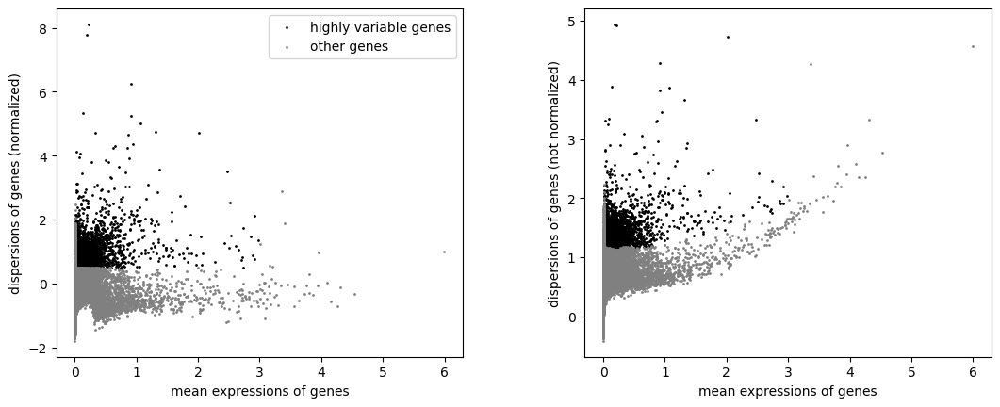

3129 out of 17543 genes are considered highly variable.


In [26]:
sc.pp.highly_variable_genes(adata, batch_key="sample")
sc.pl.highly_variable_genes(adata)
#make some variables to print a nice little summary
num_highly_variable_genes_t = adata.var['highly_variable'].sum()
total_genes_t = adata.var.shape[0]

print(f"{num_highly_variable_genes_t} out of {total_genes_t} genes are considered highly variable.")

In [27]:
Genes_of_interest, marker_genes = find_genes(adata)

 ✓ Sall1 is in adata.var
 ✓ Cx3cr1 is in adata.var
 ✓ P2ry12 is in adata.var
 ✓ P2ry13 is in adata.var
 ✓ Olfml3 is in adata.var
 ✓ Tmem119 is in adata.var
 ✓ Cd68 is in adata.var
 ✓ Itgam is in adata.var
 ✓ Cst3 is in adata.var
 ✓ Apoe is in adata.var
 ✓ B2m is in adata.var
 ✓ Ctsb is in adata.var
 ✓ Lpl is in adata.var
 ✓ Cst7 is in adata.var
 ✓ Tyrobp is in adata.var
 ✓ Trem2 is in adata.var
 ✓ Cd9 is in adata.var
 ✓ Itgax is in adata.var
 ✓ Cd63 is in adata.var
 ✓ Fth1 is in adata.var
 ✓ Spp1 is in adata.var
 ✓ Axl is in adata.var
 ✓ Mertk is in adata.var
 ✓ Mdk is in adata.var
 ✓ Ptn is in adata.var
 ✓ Syk is in adata.var
 ✓ Prkca is in adata.var
 ✓ Mef2c is in adata.var
 ✓ Elk4 is in adata.var
 ✓ Trp53 is in adata.var
 ✓ Mertk is in adata.var
 ✓ Axl is in adata.var
 ✓ Mapk14 is in adata.var
 ✓ Mapk1 is in adata.var
 ✓ Gadd45a is in adata.var
 ✓ Nfkb1 is in adata.var
 ✓ Tlr4 is in adata.var
 ✓ Nfkbia is in adata.var
 ✓ Cd40 is in adata.var
 ✓ Tlr4 is in adata.var
 ✓ Rela is in ada

In [28]:
adata.X = adata.layers["counts"].copy()
adata=annotate_cellcycle_mouse(adata)

# Calculate and print the total percentages for each phase
total_phase_percentages = {}
total_count = adata.obs.shape[0]

for p in adata.obs['phase'].unique():
    phase_count = len(adata.obs[adata.obs['phase'] == p])
    phase_percentage = round(phase_count / total_count * 100, 2)
    total_phase_percentages[p] = phase_percentage
    print(f"The percent of {p} phase in the total dataset is {phase_percentage}%")
print("\n")

# Calculate and print the percentages for each sample and compare to the total dataset
for s in adata.obs['sample'].unique():
    for p in adata.obs['phase'].unique():
        phase_count = adata[(adata.obs['phase'] == p) & (adata.obs['sample'] == s)].shape[0]
        sample_total_count = adata[adata.obs['sample'] == s].shape[0]
        sample_phase_percentage = round(phase_count / sample_total_count * 100, 2)
        total_phase_percentage = total_phase_percentages[p]
        difference = sample_phase_percentage - total_phase_percentage
        difference_statement = f"{difference:.2f}% higher" if difference > 0 else f"{-difference:.2f}% lower"
        print(f"{s} : The percent of {p} phase is {sample_phase_percentage}% ({difference_statement} than the total dataset)")
    print('\n')



       'Kif20B', 'Hn1', 'Cdc25C', 'Kif2C', 'G2E3', 'Gas2L3'],
      dtype='object')
The percent of S phase in the total dataset is 27.07%
The percent of G1 phase in the total dataset is 64.87%
The percent of G2M phase in the total dataset is 8.06%


D1 : The percent of S phase is 30.47% (3.40% higher than the total dataset)
D1 : The percent of G1 phase is 61.61% (3.26% lower than the total dataset)
D1 : The percent of G2M phase is 7.92% (0.14% lower than the total dataset)


D2 : The percent of S phase is 25.13% (1.94% lower than the total dataset)
D2 : The percent of G1 phase is 66.46% (1.59% higher than the total dataset)
D2 : The percent of G2M phase is 8.42% (0.36% higher than the total dataset)


D3 : The percent of S phase is 25.69% (1.38% lower than the total dataset)
D3 : The percent of G1 phase is 65.74% (0.87% higher than the total dataset)
D3 : The percent of G2M phase is 8.56% (0.50% higher than the total dataset)


D4 : The percent of S phase is 28.54% (1.47% higher than t

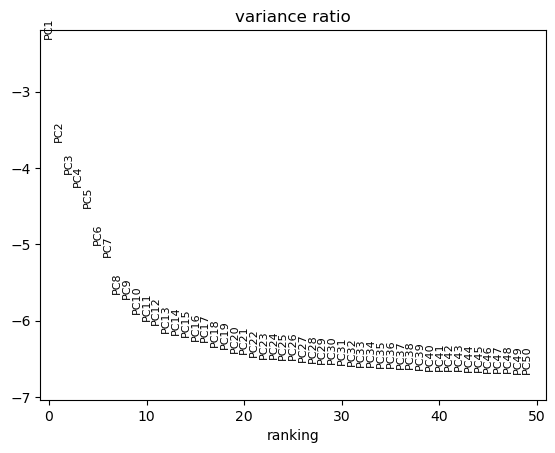

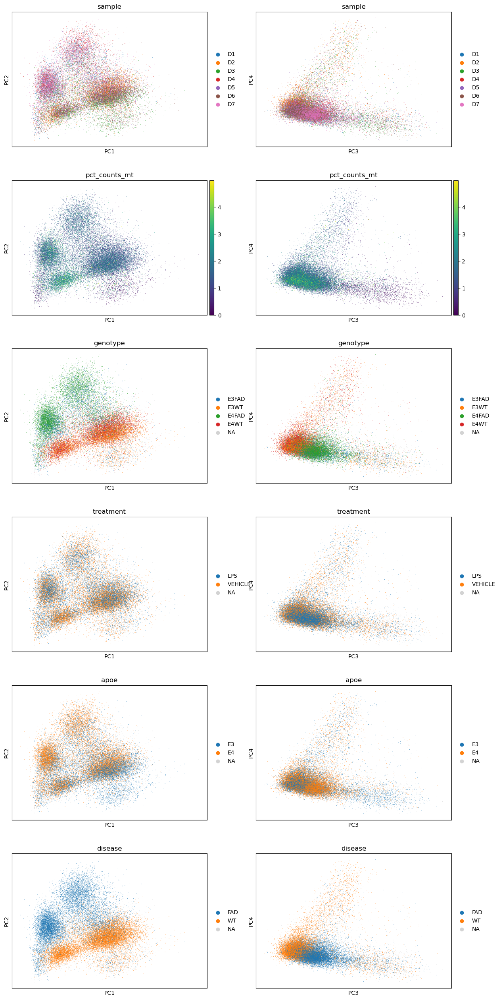

In [29]:
adata.X = adata.layers['log_norm'].copy()
sc.tl.pca(adata)
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

sc.pl.pca(
    adata,
    color=[
        "sample", "sample", "pct_counts_mt", "pct_counts_mt", 
        "genotype", "genotype", "treatment", "treatment", 
        "apoe", "apoe", "disease", "disease"
    ],
    dimensions=[
        (0, 1), (2, 3), (0, 1), (2, 3), 
        (0, 1), (2, 3), (0, 1), (2, 3), 
        (0, 1), (2, 3), (0, 1), (2, 3)
    ],
    ncols=2,
    size=2
)

In [30]:
sc.pp.neighbors(adata, n_pcs=25)

sc.tl.umap(adata)

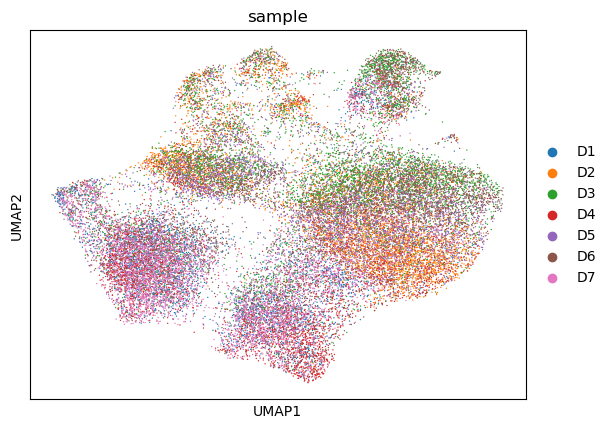

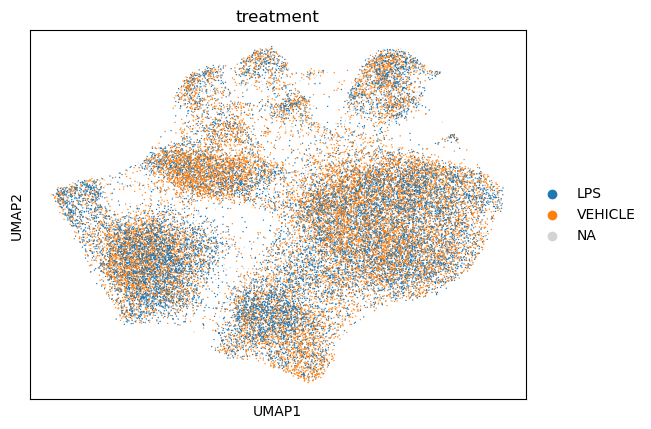

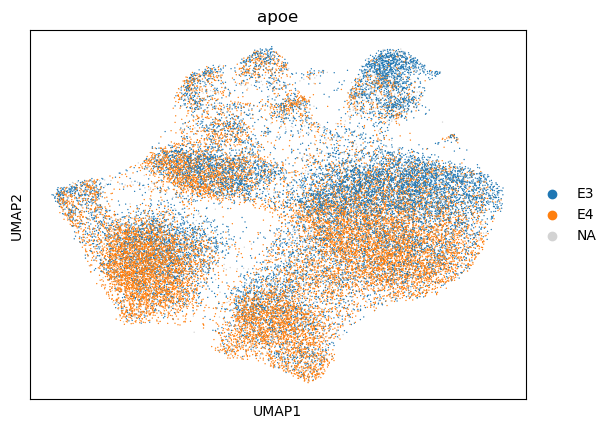

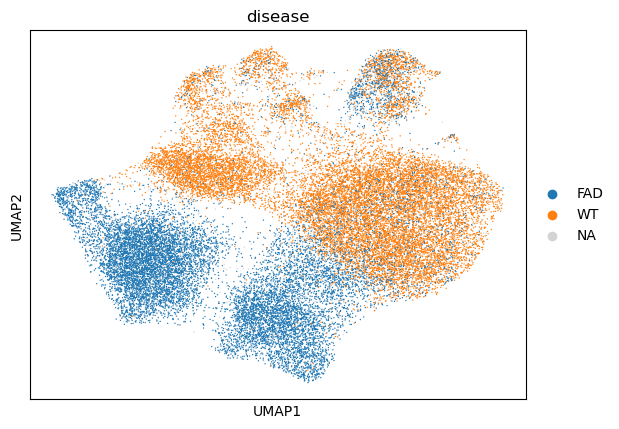

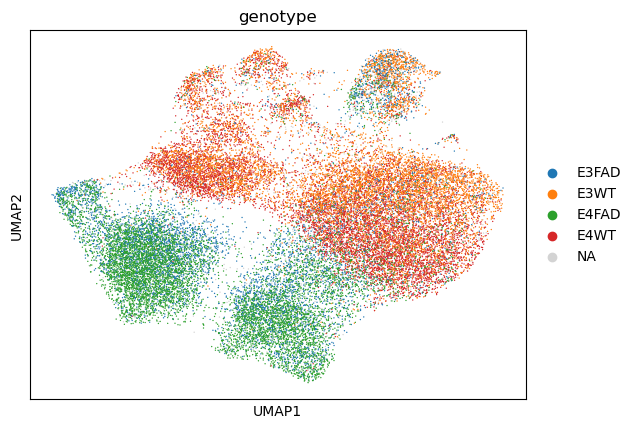

...

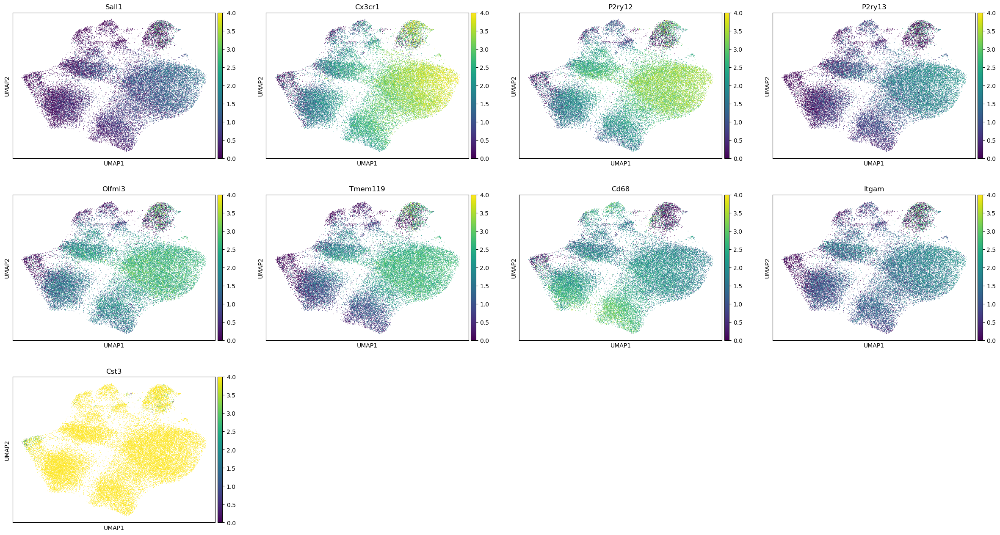

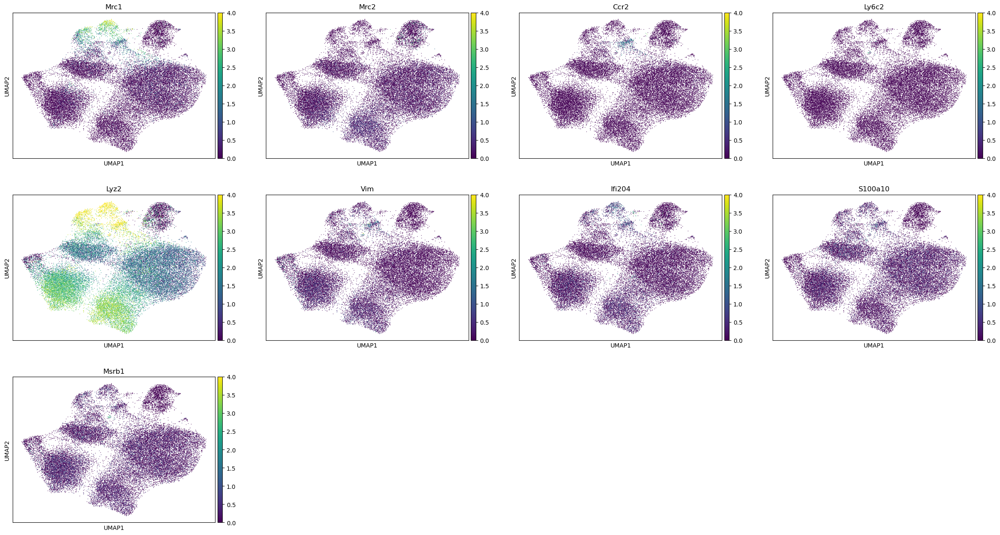

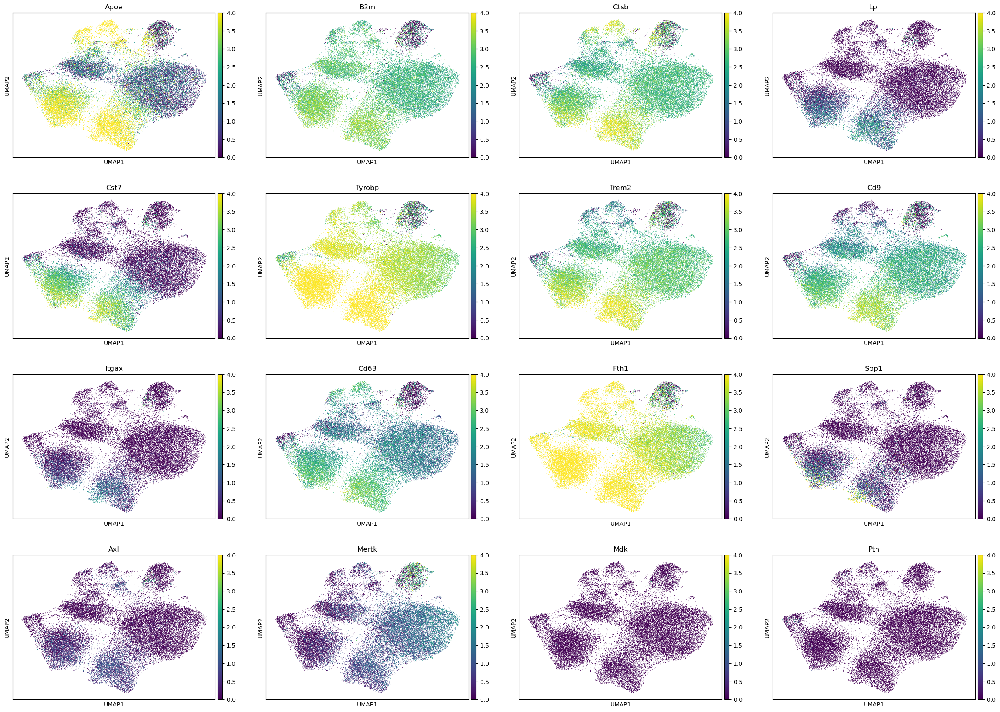

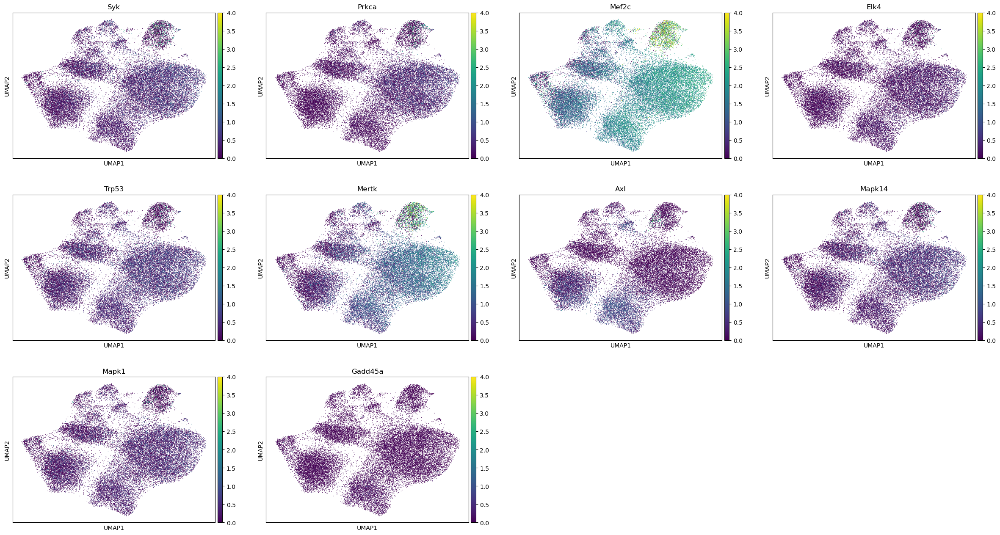

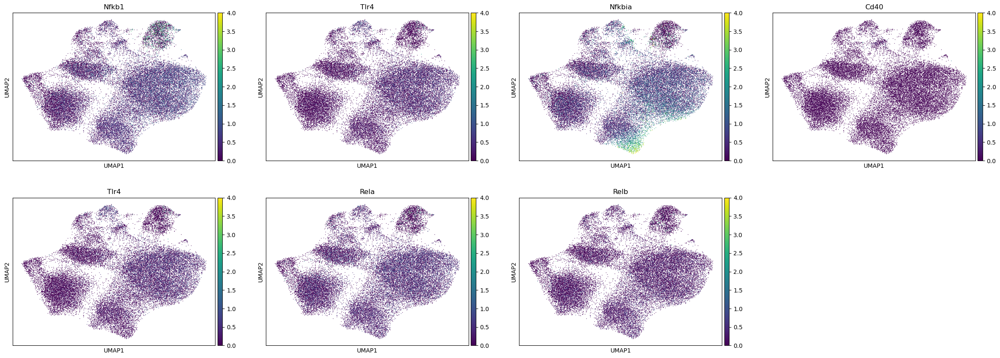

In [31]:

sc.pl.umap(adata, color="sample")

sc.pl.umap(adata, color="treatment")

sc.pl.umap(adata, color="apoe")

sc.pl.umap(adata, color="disease")

sc.pl.umap(adata, color="genotype")

sc.pl.umap(adata, color="pct_counts_mt")

sc.pl.umap(adata, color="n_genes_by_counts")

sc.pl.umap(adata, color="total_counts", vmax=5000)

sc.pl.umap(adata, color=marker_genes['Homeo'], vmax=4)

sc.pl.umap(adata, color=marker_genes['Macroph'], vmax=4)

sc.pl.umap(adata, color=marker_genes['DAM'], vmax=4)

sc.pl.umap(adata, color=marker_genes['Mapk'], vmax=4)

sc.pl.umap(adata, color=marker_genes['Nfkb'], vmax=4)
